# Genre Classification System

### Import Libraries

In [178]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy
import sys
import os
import pickle
import librosa
import librosa.display
from IPython.display import Audio
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow import keras
import plotly.express as px

### Import Dataset

In [ ]:
df = pd.read_csv('Data/features_3_sec.csv')
df.head()

### Plotting Audio Files

In [5]:
audio_recording = "Data/genres_original/country/country.00050.wav"
data, sr = librosa.load(audio_recording)
print(type(data), type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [6]:
import IPython
IPython.display.Audio(data, rate=sr)

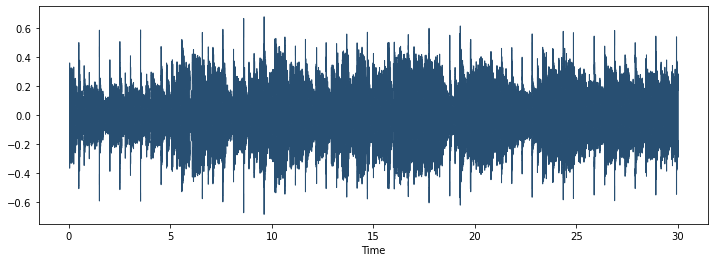

In [7]:
plt.figure(figsize = (12, 4))
librosa.display.waveshow(data, color = "#284F72")
plt.show()

c:\Users\sudee\anaconda3\lib\site-packages\librosa\util\decorators.py:88: UserWarning: Trying to display complex-valued input. Showing magnitude instead.
  return f(*args, **kwargs)


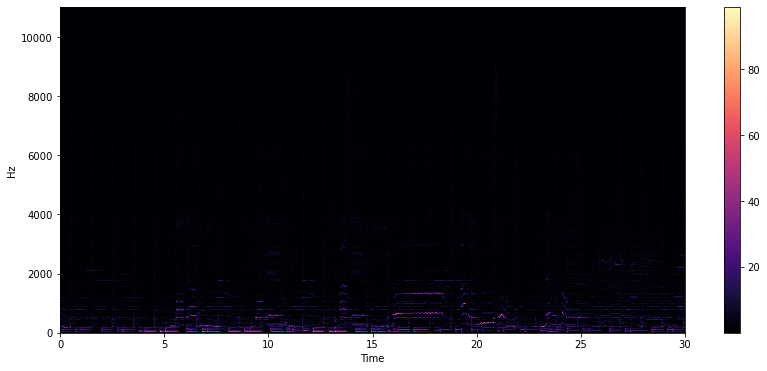

In [8]:
stft = librosa.stft(data)
stft_db = librosa.amplitude_to_db(abs(stft)) 
plt.figure(figsize=(14, 6))
librosa.display.specshow(stft, sr=sr, x_axis='time', y_axis='hz') 
plt.colorbar()

In [ ]:
plt.figure(figsize=(14, 6))
librosa.display.specshow(stft_db, sr=sr, x_axis='time', y_axis='hz') 
plt.colorbar()

In [ ]:
from sklearn.preprocessing import normalize
spectral_rolloff = librosa.feature.spectral_rolloff(data+0.01, sr=sr)[0] 
plt.figure(figsize=(12, 4))
librosa.display.waveshow(data, sr=sr, alpha=0.4, color="#284F72")

In [ ]:
import librosa.display as lplt 
chroma = librosa.feature.chroma_stft(data, sr=sr) 
plt.figure(figsize=(16,6)) 
lplt.specshow(chroma, sr=sr, x_axis='time', y_axis= 'chroma', cmap='coolwarm') 
plt.colorbar() 
plt.title("Chroma Features") 
plt.show()

In [ ]:
start=1000
end=1200
plt.figure( figsize= (14, 5))
plt.plot(data[start:end], color="#2B4F72")
plt.grid()

In [13]:
zero_cross_rate = librosa.zero_crossings(data[start:end], pad=False) 
print("The number of zero-crossings is ",sum(zero_cross_rate))

The number of zero-crossings is  8


### Pre-Processing of Dataset

In [ ]:
df = df.drop(labels='filename',axis=1)
df = df.drop(labels='length',axis=1)
df.head()

In [15]:
class_list = df.iloc[:, -1]
print(np.unique(np.array(class_list)))
convertor=LabelEncoder()
y = convertor.fit_transform(class_list)
print(np.unique(np.array(y)))

['blues' 'classical' 'country' 'disco' 'hiphop' 'jazz' 'metal' 'pop'
 'reggae' 'rock']
[0 1 2 3 4 5 6 7 8 9]


In [ ]:
from sklearn.preprocessing import StandardScaler
fit = StandardScaler()
z= fit.fit(np.array(df.iloc[:, :-1], dtype= float))
X=z.transform(np.array(df.iloc[:, :-1], dtype= float))
X

### Building and Training the Model

In [18]:
X_train, X_test, y_train, y_test= train_test_split(X, y, test_size=0.33)

In [19]:
from keras.models import Sequential
#from keras.wrappers.scikit learn import KerasClassifier 
def trainModel (model, epochs, optimizer):
  batch_size=128 
  #callback myCallback() 
  model.compile(optimizer=optimizer,
                loss='sparse_categorical_crossentropy',
                metrics='accuracy') 
  return model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=epochs, batch_size=batch_size)

In [20]:
model=keras.models.Sequential([
    keras.layers.Dense(512, activation='relu', input_shape=(X_train.shape[1],)),
    keras.layers.Dropout(0.2),
    keras.layers.Dense(256, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.Dense(128, activation='relu'), 
    keras.layers.Dropout (0.2),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.Dense(10, activation='softmax'),])
print(model.summary())
model_history=trainModel(model=model, epochs=600, optimizer='adam')

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 512)               29696     
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               131328    
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)             (None, 64)                8

In [21]:
test_loss, test_acc=model.evaluate(X_test, y_test, batch_size=128) 
print("The test Loss is :", test_loss) 
print("\nThe Best test Accuracy is ", test_acc*100)

26/26 [==============================] - 0s 3ms/step - loss: 0.6318 - accuracy: 0.9154
The test Loss is : 0.6318311095237732

The Best test Accuracy is  91.53776168823242


In [196]:
print("Validation Accuracy",max(model_history.history["val_accuracy"]))
df = pd.DataFrame(model_history.history)
print(df)
fig1 = px.line(df, title="CNN Model Evaluation Plot")
fig1.show()

Validation Accuracy 0.9256899952888489
         loss  accuracy  val_loss  val_accuracy
0    1.643575  0.412072  1.174280      0.605096
1    1.142350  0.604512  0.912259      0.691234
2    0.919969  0.686986  0.796550      0.724295
3    0.773445  0.737338  0.688029      0.763118
4    0.680958  0.773943  0.644019      0.787079
..        ...       ...       ...           ...
595  0.009880  0.996713  0.577172      0.918411
596  0.011956  0.995518  0.620466      0.913558
597  0.008392  0.997311  0.614534      0.917197
598  0.008651  0.997311  0.576148      0.916288
599  0.005746  0.997908  0.631831      0.915378

[600 rows x 4 columns]


In [23]:
#model.save("saved_model")

### Predict Genre from Audio File

In [45]:
import librosa
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import csv
# Preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
#Keras
import keras
from os import path
from pydub import AudioSegment

In [52]:
header = 'name chroma_stft_mean chroma_stft_var rms_mean rms_var spectral_centroid_mean spectral_centroid_var spectral_bandwidth_mean spectral_bandwidth_var rolloff_mean rolloff_var zero_crossing_rate_mean zero_crossing_rate_var harmony_mean harmony_var perceptr_mean perceptr_var tempo'
for i in range(1, 21):
    header += f' mfcc{i}_mean mfcc{i}_var'
header = header.split()
print(header)

['name', 'chroma_stft_mean', 'chroma_stft_var', 'rms_mean', 'rms_var', 'spectral_centroid_mean', 'spectral_centroid_var', 'spectral_bandwidth_mean', 'spectral_bandwidth_var', 'rolloff_mean', 'rolloff_var', 'zero_crossing_rate_mean', 'zero_crossing_rate_var', 'harmony_mean', 'harmony_var', 'perceptr_mean', 'perceptr_var', 'tempo', 'mfcc1_mean', 'mfcc1_var', 'mfcc2_mean', 'mfcc2_var', 'mfcc3_mean', 'mfcc3_var', 'mfcc4_mean', 'mfcc4_var', 'mfcc5_mean', 'mfcc5_var', 'mfcc6_mean', 'mfcc6_var', 'mfcc7_mean', 'mfcc7_var', 'mfcc8_mean', 'mfcc8_var', 'mfcc9_mean', 'mfcc9_var', 'mfcc10_mean', 'mfcc10_var', 'mfcc11_mean', 'mfcc11_var', 'mfcc12_mean', 'mfcc12_var', 'mfcc13_mean', 'mfcc13_var', 'mfcc14_mean', 'mfcc14_var', 'mfcc15_mean', 'mfcc15_var', 'mfcc16_mean', 'mfcc16_var', 'mfcc17_mean', 'mfcc17_var', 'mfcc18_mean', 'mfcc18_var', 'mfcc19_mean', 'mfcc19_var', 'mfcc20_mean', 'mfcc20_var']


In [53]:
file = open('data.csv', 'a', newline='')
with file:
    writer = csv.writer(file)
    writer.writerow(header)

In [ ]:
directory = "C:/Users/sudee/OneDrive/Desktop/projects/PA/Genre Classification/Music/"
output_file = "result.wav"
for file in os.listdir(directory):
    my_file = os.path.join(directory, file)
    sound = AudioSegment.from_mp3(my_file)
    sound.export(output_file, format="wav")
    songname = f'result.wav'
    y, sr = librosa.load(songname, mono=True, duration=30)
    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
    rmse = librosa.feature.rms(y=y)[0]
    spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
    spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
    rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
    zcr = librosa.feature.zero_crossing_rate(y)
    harmonic = librosa.effects.harmonic(y=y)
    perceptr = librosa.effects.percussive(y=y)
    mfcc = librosa.feature.mfcc(y=y, sr=sr)
    tempo = librosa.beat.tempo(y=y, sr=sr)
    to_append = f'{file} {np.mean(chroma_stft)} {np.var(chroma_stft)} {np.mean(rmse)} {np.var(rmse)} {np.mean(spec_cent)} {np.var(spec_cent)} {np.mean(spec_bw)} {np.var(spec_bw)} {np.mean(rolloff)} {np.var(rolloff)} {np.mean(zcr)} {np.var(zcr)} {np.mean(harmonic)} {np.var(harmonic)} {np.mean(perceptr)} {np.var(perceptr)} {np.mean(tempo)}'    
    for e in mfcc:
        to_append += f' {np.mean(e)} {np.var(e)}'

    print(to_append)
    file = open('data.csv', 'a', newline='')
    with file:
        writer = csv.writer(file)
        writer.writerow(to_append.split())

In [197]:
df = pd.read_csv('data.csv')
df

,name,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
0,24k_magic.mp3,0.447259,0.089772,0.268961,0.006627,2661.691806,852536.987703,2620.133834,183134.832902,5685.632286,...,7.182944,60.498753,-7.310027,72.869766,10.302364,86.463226,-3.853395,85.994171,7.815805,78.236374
1,angel_of_death.mp3,0.620491,0.051823,0.232580,0.001422,3129.300162,211912.659662,2607.662831,31594.563827,6116.321349,...,7.847942,24.207485,-8.561872,23.660900,6.848320,17.938595,-5.935910,23.574965,6.227671,19.143316
2,blinding.mp3,0.413992,0.082264,0.303647,0.005714,2403.434187,655346.404259,2502.174420,137378.843557,5167.068755,...,4.103420,44.161312,-6.348854,42.651592,7.855659,45.598042,-2.139206,62.951252,12.179219,66.972466
3,eminem_rap_god.mp3,0.391850,0.091883,0.269059,0.008262,2354.570962,897297.161218,2322.468995,276418.843801,4632.855319,...,6.764558,62.493813,-10.172311,50.501930,5.193294,58.875942,-3.556481,64.330559,2.324621,53.656857
4,mozart_classic.mp3,0.211787,0.085305,0.080697,0.002716,925.554084,43083.609919,1087.242415,75086.232844,1523.249122,...,-5.477241,119.007568,-10.526232,103.080177,-4.224711,87.983711,-3.543641,70.237091,-4.597531,136.644577
5,nanchak.mp3,0.506156,0.087415,0.253803,0.017939,2698.331707,838991.482867,2856.727618,190907.607279,6271.587077,...,5.675025,86.855309,-5.453852,68.951164,7.779562,59.798023,-6.387860,70.043243,-0.078454,71.699440
6,night_fever_disco.mp3,0.373885,0.084838,0.112127,0.001268,2370.107749,508828.998109,2619.519098,188439.044342,5413.208934,...,6.941274,60.636307,-3.741443,83.035042,1.662367,79.289284,-6.611274,113.267342,8.684837,72.980782
7,purple_haze.mp3,0.435694,0.084136,0.187512,0.003197,2355.993475,237681.948386,2109.503381,84140.149592,4489.397853,...,4.156933,27.740984,-18.716890,34.058491,0.807191,38.306736,0.352380,47.507412,1.510076,49.417118
8,reggae_bob.mp3,0.393482,0.095247,0.175453,0.006026,2080.100221,860930.932633,2478.889915,330430.696609,4560.680756,...,1.925991,89.628372,-7.856175,98.318314,2.300153,68.534554,-6.936587,75.710434,2.614253,102.920692
9,rock_and_roll.mp3,0.435333,0.078401,0.176033,0.000775,2624.394391,146829.043621,2621.686063,35458.340989,5750.931892,...,7.560236,29.548708,-5.116095,33.865807,2.003243,39.950302,-10.837472,32.895279,0.705888,32.215374


In [198]:
df1 = df
df1.set_index("name", inplace = True)

In [ ]:
fig2 = px.line(df1, title="Feature Extraction Output")
fig2.show()

In [200]:
df = df.reset_index()
df_name=df[['name']]
df = df.drop(labels='name',axis=1)

In [ ]:
predict_list = []

for i in range(len(df)):
    predict_input = (df.loc[i]).values.tolist()
    predict_list.append(predict_input)
predict_list

In [ ]:
B= z.transform(np.array(predict_list, dtype= float))
B

In [ ]:
output_label = model.predict(B)
print(output_label)

In [ ]:
genre = ['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz', 'metal', 'pop', 'reggae', 'rock']
df = pd.DataFrame(output_label,columns =genre)
df

In [ ]:
df.insert(loc = 0,
          column = 'name',
          value = df_name['name'])
# show the dataframe
df

In [206]:
df1 = df
df1.set_index("name", inplace = True)

In [207]:
fig3 = px.bar(df.T, title="Genre Prediction Output")
fig3.show()

# Song Recommendation System

In [251]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly
from sklearn.preprocessing import StandardScaler
from scipy.spatial import distance
import copy
import warnings
warnings.filterwarnings("ignore")
plotly.offline.init_notebook_mode (connected = True)

In [ ]:
data=pd.read_csv('genres_v2.csv')
data.head()

In [253]:
fig4 = px.line(data[data.columns[:11]],title='Features of Dataset')
fig4.show()

In [ ]:
fig5 = px.pie(data,names=data[data.columns[-4]],title="Genre Distribution of Dataset")
fig5.show()

### Dataset Preprocessing

In [255]:
cols=list(data.columns[11:])
del cols[7]
df=copy.deepcopy(data)
df.drop(columns=cols,inplace=True)
data.drop('Unnamed: 0',axis=1,inplace=True)

In [ ]:
x=list(data.corr().columns)
y=list(data.corr().index)
values=np.array(data.corr().values)
fig6 = go.Figure(data=go.Heatmap(
    z=values,
    x=x,
    y=y,
    hoverongaps = False, colorscale='Aggrnyl'))
fig6.update_layout(title='Correlation Heatmap of Dataset')
fig6.show()

In [257]:
data=data.dropna(subset=['song_name'])
df=data[data.columns[:11]]
df['genre']=data['genre']
df['time_signature']=data['time_signature']
df['duration_ms']=data['duration_ms']
df['song_name']=data['song_name']

In [258]:
x=df[df.drop(columns=['song_name','genre']).columns].values
scaler = StandardScaler().fit(x)
X_scaled = scaler.transform(x)
df[df.drop(columns=['song_name','genre']).columns]=X_scaled

In [259]:
def find_word(word,words):
    t=[]
    count=0
    if word[-1]==' ':
        word=word[:-1]
    for i in words:
        if word.lower() in i.lower():
            t.append([len(word)/len(i),count])
        else:
            t.append([0,count])
        count+=1
    t.sort(reverse=True)
    return words[t[0][1]]

### Recommendation System Using Euclidean Distance

In [260]:
def make_matrix(data,song,number):
    df=pd.DataFrame()
    data.drop_duplicates(inplace=True)
    songs=data['song_name'].values
    best=find_word(song,songs)
    print('The song closest to your search is :',best)
    genre=data[data['song_name']==best]['genre'].values[0]
    df=data[data['genre']==genre]
    x=df[df['song_name']==best].drop(columns=['genre','song_name']).values
    if len(x)>1:
        x=x[1]
    song_names=df['song_name'].values
    df.drop(columns=['genre','song_name'],inplace=True)
    df=df.fillna(df.mean())
    p=[]
    r=[]
    count=0
    for i in df.values:
        r.append(distance.euclidean(x,i))
        p.append([distance.euclidean(x,i),count])
        count+=1
    p.sort()
    r.sort()
    ls=[]
    for i in range(1,number+1):
        ls.append(song_names[p[i][1]])     
    df1 = {'song':ls,'euclidean_dist':r[1:number+1]}
    return df1

In [261]:
a=input('Please enter The name of the song :')
b=int(input('Please enter the number of recommendations you want: '))
df1 = make_matrix(df,a,b)
df1 = pd.DataFrame(df1)

The song closest to your search is : Candy Shop


In [262]:
fig7 = px.line(df1,x=df1['song'],y=df1['euclidean_dist'],title='Recommendationn Using Euclidean Distance',markers=True)
fig7.show()

### Recommendation System Using Cosine Similarity Distance

In [263]:
def make_matrix_cosine(data,song,number):
    df=pd.DataFrame()
    data.drop_duplicates(inplace=True)
    songs=data['song_name'].values
    best=find_word(song,songs)
    print('The song closest to your search is :',best)
    genre=data[data['song_name']==best]['genre'].values[0]
    df=data[data['genre']==genre]
    x=df[df['song_name']==best].drop(columns=['genre','song_name']).values
    if len(x)>1:
        x=x[1]
    song_names=df['song_name'].values
    df.drop(columns=['genre','song_name'],inplace=True)
    df=df.fillna(df.mean())
    p=[]
    r=[]
    count=0
    for i in df.values:
        r.append(distance.cosine(x,i))
        p.append([distance.cosine(x,i),count])
        count+=1
    p.sort()
    r.sort()
    ls=[]
    for i in range(1,number+1):
        ls.append(song_names[p[i][1]])     
    df1 = {'song':ls,'cosine_dist':r[1:number+1]}
    return df1

In [264]:
c=input('Please enter The name of the song :')
d=int(input('Please enter the number of recommendations you want: '))
df1 = make_matrix_cosine(df,c,d)
df1 = pd.DataFrame(df1)

The song closest to your search is : Candy Shop


In [265]:
fig8 = px.line(df1,x=df1['song'],y=df1['cosine_dist'],title='Recommendationn Using Cosine Similarity Distance',markers=True)
fig8.show()

### Recommendation System Using Correlation Distance

In [266]:
def make_matrix_correlation(data,song,number):
    df=pd.DataFrame()
    data.drop_duplicates(inplace=True)
    songs=data['song_name'].values
    best=find_word(song,songs)
    print('The song closest to your search is :',best)
    genre=data[data['song_name']==best]['genre'].values[0]
    df=data[data['genre']==genre]
    x=df[df['song_name']==best].drop(columns=['genre','song_name']).values
    if len(x)>1:
        x=x[1]
    song_names=df['song_name'].values
    df.drop(columns=['genre','song_name'],inplace=True)
    df=df.fillna(df.mean())
    p=[]
    r=[]
    count=0
    for i in df.values:
        r.append(distance.correlation(x,i))
        p.append([distance.correlation(x,i),count])
        count+=1
    p.sort()
    r.sort()
    ls=[]
    for i in range(1,number+1):
        ls.append(song_names[p[i][1]])     
    df1 = {'song':ls,'correlation_dist':r[1:number+1]}
    return df1

In [267]:
e=input('Please enter The name of the song :')
f=int(input('Please enter the number of recommendations you want: '))
df1 = make_matrix_correlation(df,e,f)
df1 = pd.DataFrame(df1)

The song closest to your search is : Candy Shop


In [268]:
fig9 = px.line(df1,x=df1['song'],y=df1['correlation_dist'],title='Recommendationn Using Correlation Distance',markers=True)
fig9.show()

# Data Visualization

In [269]:
import dash
import dash_core_components as dcc
import dash_html_components as html
import plotly.express as px
import pandas as pd
 
external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']
 
app = dash.Dash(__name__, external_stylesheets=external_stylesheets)
 
colors = {
    'background': '#F0F8FF',
    'text': '#00008B'
}

In [270]:
from dash import Dash, dcc, html, Input, Output,dash_table
import librosa
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import csv
# Preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
#Keras
import keras 

df = pd.read_csv('Data/features_3_sec.csv')
fig = px.scatter(df, x="chroma_stft_mean", y="rms_mean", color="label", size="spectral_centroid_mean", title="Plot of Dataset")


app.layout = html.Div(children=[
    html.H1(children='Music Classification & Recommendation System'),
 
    html.H2(children='''
        Music Genre Classification
    '''),

    dcc.Graph(
        id='example-graph',
        figure=fig
    ),

    dcc.Graph(
        id='example-graph1',
        figure=fig1
    ),

    dcc.Graph(
        id='example-graph2',
        figure=fig2
    ),

    dcc.Graph(
        id='example-graph3',
        figure=fig3
    ),

    html.H2(children='''
        Music Song Recommendation 
    '''),

    dcc.Graph(
        id='example-graph4',
        figure=fig4
    ),

    dcc.Graph(
        id='example-graph5',
        figure=fig5
    ),

    dcc.Graph(
        id='example-graph6',
        figure=fig6
    ),

    dcc.Graph(
        id='example-graph7',
        figure=fig7
    ),

    dcc.Graph(
        id='example-graph8',
        figure=fig8
    ),

    dcc.Graph(
        id='example-graph9',
        figure=fig9
    ),
])

In [274]:
if __name__ == '__main__':
    app.run_server(debug=True, use_reloader=False)

Dash is running on http://127.0.0.1:8050/

Dash is running on http://127.0.0.1:8050/

Dash is running on http://127.0.0.1:8050/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: on
